In [ ]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow

import os
import torch 
from roboflow import Roboflow
from IPython.display import Image, clear_output

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12824, done.
remote: Total 12824 (delta 0), reused 0 (delta 0), pack-reused 12824
Receiving objects: 100% (12824/12824), 11.81 MiB | 18.30 MiB/s, done.
Resolving deltas: 100% (8913/8913), done.
/content/yolov5/yolov5
Setup complete. Using torch 1.10.0+cu111 (Tesla V100-SXM2-16GB)


In [ ]:
# Replaced key
rf = Roboflow(api_key = "xxxxxx")
project = rf.workspace("xxxxx").project("xxxxxx")
dataset = project.version(5).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to robotics-5 in yolov5pytorch:: 100%|██████████| 14944/14944 [00:01<00:00, 8476.16it/s] 


In [ ]:
os.environ["DATASET_DIRECTORY"] = "/content/datasets" # Set up environment

In [ ]:
# Train the custom YOLOv5 model from scratch
!python train.py --batch 16 --epochs 150 --data {dataset.location}/data.yaml --cfg models/yolov5s.yaml --cache

train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/yolov5/yolov5/robotics-5/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-132-g014acde torch 1.10.0+cu111 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.0

In [ ]:
from utils.plots import plot_results
plot_results('runs/train/exp2/results.csv')

In [ ]:
# Run inference with the model
!python detect.py --weights runs/train/exp2/weights/best.pt --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/yolov5/yolov5/robotics-5/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-132-g014acde torch 1.10.0+cu111 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/271 /content/yolov5/yolov5/robotics-5/test/images/_0322000007_png_jpg.rf.172e4c4af7d8dc0f697cca8bb4cef1c5.jpg: 640x640 Done. (0.008s)
image 2/271 /content/yolov5/yolov5/robotics-5/test/images/_0322000011_png_jpg.rf.73ae3d9123aac4367f19745e8d23802d.jpg: 640x640 Done. (0.008s)
image 3/271 /content/yolov5/yolov5/robotics-5/test

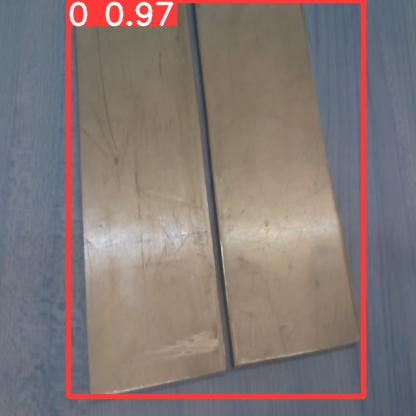

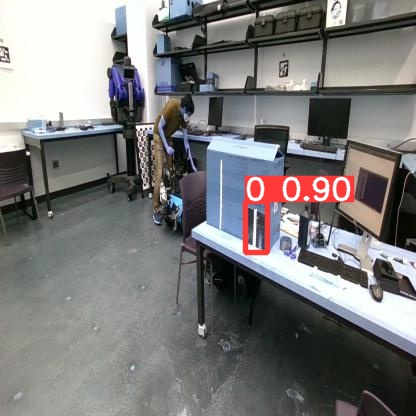

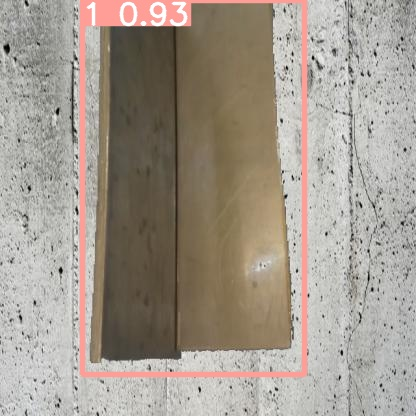

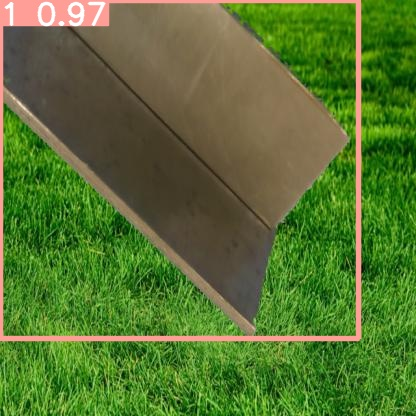

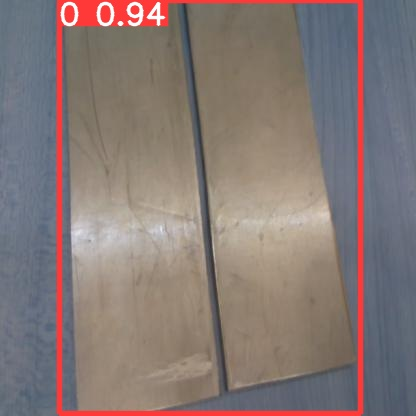

...

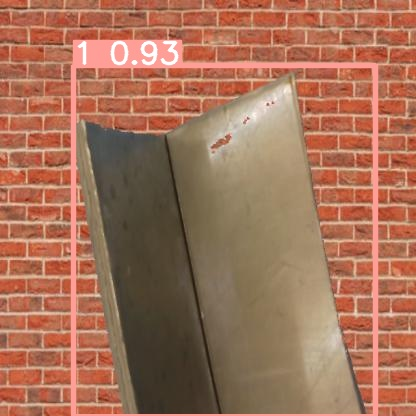

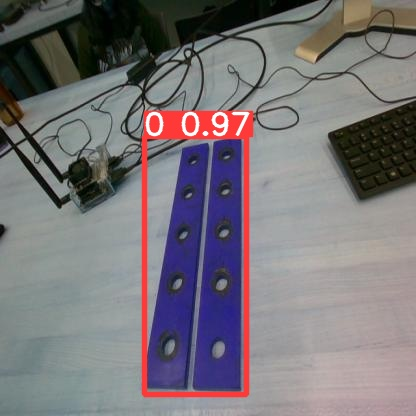

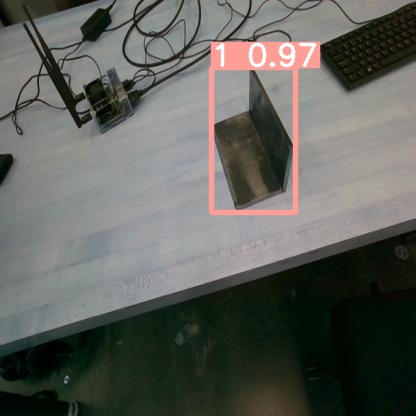

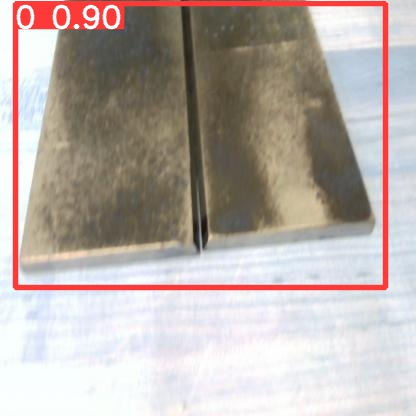

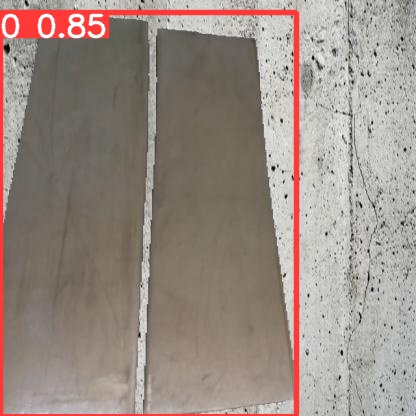

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('runs/train/exp2/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>